In [1]:
%matplotlib inline
import pandas as pd
from ipywidgets import widgets
from IPython.display import display
import numpy as np
import matplotlib.pyplot as plt

In [2]:
from sklearn.model_selection import train_test_split
from sklearn import tree
import sklearn.metrics as metrics

In [3]:
import pydotplus 
from IPython.display import Image
from sklearn.metrics import confusion_matrix

In [4]:
pd.options.mode.chained_assignment = None

In [5]:
df = pd.read_csv('data/Data.csv', sep = '\t', encoding = 'utf-8')

In [6]:
df.shape

(821464, 82)

In [7]:
subs = df[df['Subscription']>0]

In [8]:
subs.shape

(133419, 82)

In [9]:
subs['Month'] = pd.to_datetime(pd.Series(subs['Month']), format='%b-%Y')

In [10]:
subs['created_at'] = pd.to_datetime(pd.Series(subs['created_at']))

In [11]:
subs['updated_at'] = pd.to_datetime(pd.Series(subs['updated_at']))

In [12]:
subs['New_Duration'] = subs['Month'] - subs['created_at']

In [13]:
subs['New_Duration'] = subs['New_Duration']/ np.timedelta64(1, 'D')

In [58]:
#writer = pd.ExcelWriter('data/subs.xlsx', engine='xlsxwriter')
#df.to_excel(writer, sheet_name='Sheet1')
#writer.save()

In [59]:
subs.to_csv('data/subs.csv', encoding = 'utf-8')

In [14]:
last_record = pd.read_csv('data/LastRecord.csv', encoding='utf-8')

In [15]:
last_record.head(5)

,Unnamed: 0,Athlete,Subscription,Month,gender,sport,SegmentName,Duration,EventsAttended,EventsAttended_Frequency,...,subscription_Ended,Subscriptions_EOM,RecencyNow,RecencyStat,AthleteRecordNumber,created_at,updated_at,status,ID,AthleteSub
0,0,215018,617124,Aug-2013,F,softball,NaN,37,0,0,...,1,0,1156,0,20,2013-07-03 20:45:00,2013-08-09 21:49:00,NaN,20,2150181
1,1,215069,241447,May-2014,F,soccer,NaN,851,0,2,...,1,0,883,41788,29,2012-01-01 16:43:00,2014-05-01 09:52:00,NaN,85,2150690
2,2,215142,842682,May-2015,F,softball,NaN,428,0,30,...,1,0,518,42153,41,2014-03-17 03:23:00,2015-05-19 15:41:00,NaN,153,2151421
3,3,215162,982960,Dec-2014,M,lacrosse,NaN,122,0,9,...,1,0,669,41991,36,2014-08-13 13:14:00,2014-12-13 14:42:00,NaN,204,2151622
4,4,215195,493522,Mar-2013,F,soccer,NaN,24,0,26,...,1,0,1309,0,15,2013-02-08 22:26:00,2013-03-04 16:06:00,NaN,239,2151951


Percent values missing: 0.000000%


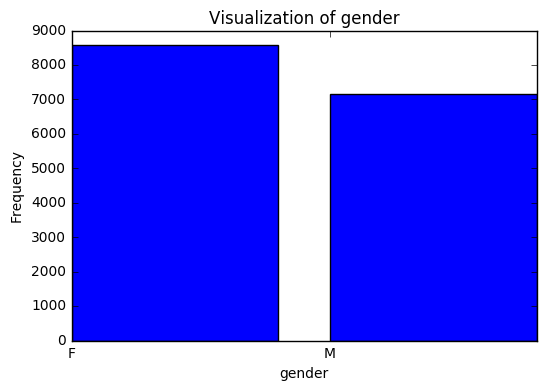

In [16]:
features = [feature for feature in last_record.columns.values]

features_dropdown = widgets.Dropdown(
    options=features,
    value='EventsAttended',
    description='Feature',
    disabled=False,
    button_style='info'
)

categorical_features = [cat_feature for cat_feature in last_record.columns.values if last_record[cat_feature].dtype == 'object']
#categorical_features.extend(['MSSubClass', 'OverallQual', 'OverallCond', 'BsmtFullBath', 
#                             'BsmtHalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 
#                             'TotRmsAbvGr', 'Fireplaces', 'GarageCars', 'MoSold', 'YrSold'])


def display_stats(feature):
    
    if feature in categorical_features:
        stringified = last_record[feature].apply(lambda x: str(x)).values
        print("Percent values missing: %f%%" % (100*(np.sum(stringified == 'nan') / len(last_record[feature].values))))
        
        nan_indices = np.where(stringified == 'nan')[0]
        stringified = np.delete(stringified, nan_indices)
        
        labels = np.unique(stringified)
        data = [np.sum(stringified == l) for l in labels]
        fig = plt.figure()
        ax = fig.add_subplot(1, 1, 1)
        ax.set_title('Visualization of %s' % feature)
        ax.set_xlabel(feature)
        ax.set_ylabel('Frequency')
        if feature == 'MoSold':
            labels = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
        ax.bar(range(len(data)), data, tick_label=labels)
        #ax.xticks(range(len(lables)), labels)
        plt.show()
    else:
        x = last_record[feature].values
    
        #find zero indices
        zero_indices = np.where(x == 0)[0]
        nan_indices = np.where(np.isnan(x))[0]
        #delete these datapoints from x and y
    
        x = np.delete(x, zero_indices)
        x = np.delete(x, nan_indices)
        
        print('Mean: %.2f' % np.mean(x))
        print('Variance: %.2f' % np.var(x))
        # we don't count zeros as missing
        print('Percent values missing: %f%%' % (100*((len(nan_indices)) / len(last_record[feature].values))))
    
        fig1 = plt.figure(1)
        ax1 = fig1.add_subplot(1, 1, 1)
        ax1.set_title('Histogram of %s' % feature)
        ax1.set_xlabel(feature)
        ax1.set_ylabel('Frequency')
        ax1.hist(x)
        ax1.
        
        fig2 = plt.figure(2)
        ax2= fig2.add_subplot(1, 1, 1)
        ax2.set_title('Boxplot of %s' % feature)
        ax2.boxplot([list(x)], labels=[feature])
        plt.show()

widgets.interact(display_stats, feature=features_dropdown)

In [63]:
last_record.shape

(15737, 82)

In [64]:
len(last_record[last_record['MSG_CHURN']==0])

9669

In [65]:
len(last_record[last_record['MSG_CHURN']==1])

6068

In [66]:
last_record['Month'].dtype

dtype('O')

In [67]:
last_record['Month'] = pd.to_datetime(pd.Series(last_record['Month']), format='%b-%Y')

In [68]:
last_record['created_at'] = pd.to_datetime(pd.Series(last_record['created_at']))

In [69]:
last_record['updated_at'] = pd.to_datetime(pd.Series(last_record['updated_at']))

In [70]:
last_record['New_Duration'] = last_record['Month'] - last_record['created_at']

In [71]:
last_record['New_Duration'] = last_record['New_Duration']/ np.timedelta64(1, 'D')

In [72]:
last_record.to_csv('data/Last_Record.csv', encoding='utf-8')

In [73]:
last_record.drop(['SegmentName', 'Emails_Recency', 'status', 'Duration','EventsAttended_LastDate','Hits_LastDate',
            'CollegeProspects_LastDate','created_at','updated_at','Month','Unnamed: 0',
            'MSG_CHURN', 'Made_Team?','New_Duration','ID','subscription_Ended',
            'AthleteSub','Athlete','Subscription','NumYear'], axis=1, inplace=True)

In [74]:
last_record.drop(['DateNum'], axis = 1, inplace = True)

In [75]:
Y = last_record['CaptainU_CHURN']

In [76]:
last_record.drop(['CaptainU_CHURN'], axis = 1, inplace = True)

In [77]:
last_record = last_record.replace('NaN',0)

In [78]:
last_record.shape

(15737, 61)

In [79]:
last_record = pd.get_dummies(last_record)

In [80]:
X_train, X_test, y_train, y_test = train_test_split(last_record, Y, test_size=0.20, random_state=42)

In [81]:
clf = tree.DecisionTreeClassifier()
clf = clf.fit(X_train,y_train )

In [82]:
prediction = clf.predict(X_test)

In [83]:
accuracy = clf.score(X_test, y_test)
accuracy

0.89739517153748416

In [84]:
dot_data = tree.export_graphviz(clf, out_file=None) 
graph = pydotplus.graph_from_dot_data(dot_data) 
graph.write_pdf("data/last_record.pdf")

True

In [85]:
dot_data = tree.export_graphviz(clf, out_file=None, 
                         feature_names=last_record.columns,    
                         filled=True, rounded=True,
                         special_characters=True) 

In [86]:
graph = pydotplus.graph_from_dot_data(dot_data)
Image(graph.create_png()) 

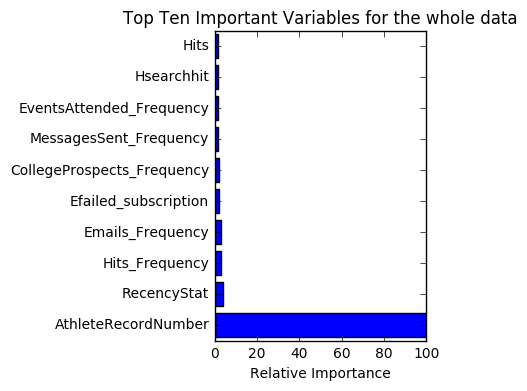

In [87]:
feature_importance = clf.feature_importances_
#print(feature_importance)
# make importances relative to max importance
feature_importance = 100.0 * (feature_importance / feature_importance.max())
#print(len(feature_importance))
#print(feature_importance)
sorted_idx = np.argsort(feature_importance)[::-1][:10]
pos = np.arange(sorted_idx.shape[0]) + .5
plt.subplot(1, 2, 2)
plt.barh(pos, feature_importance[sorted_idx], align='center')
plt.yticks(pos, X_test.columns[sorted_idx])
plt.xlabel('Relative Importance')
plt.title('Top Ten Important Variables for the whole data')
plt.show()

In [88]:
confusion_matrix(y_test, prediction)

array([[1757,  158],
       [ 165, 1068]])

In [89]:
metrics.recall_score(y_test, prediction)

0.86618004866180054

In [93]:
metrics.precision_score(y_test, prediction)

0.87112561174551384

In [90]:
metrics.roc_auc_score(y_test, prediction)

0.89183676062332851

In [91]:
output = pd.DataFrame(data = {"Actual":y_test, "prediction":prediction})
output.to_csv("data/Prediction.csv", index = False, quoting = 3)

In [92]:
labels = ['1', '0']
cm = confusion_matrix(y_test, prediction, labels)
print(cm)
fig = plt.figure()
ax = fig.add_subplot(111)
cax = ax.matshow(cm)
pl.title('Confusion matrix of the classifier')
fig.colorbar(cax)
ax.set_xticklabels([''] + labels)
ax.set_yticklabels([''] + labels)
pl.xlabel('Predicted')
pl.ylabel('True')
pl.show()

/Users/jamesmwakichako/Documents/Kaggle/kaggle_py/lib/python3.5/site-packages/sklearn/metrics/classification.py:248: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if np.all([l not in y_true for l in labels]):


ValueError: At least one label specified must be in y_true